In [1]:
import pandas as pd
import numpy as np
from tqdm import tqdm
import scipy.stats

import matplotlib.pyplot as plt
#import seaborn as sns
import librosa
import librosa.display
from IPython.display import Audio

from pathlib import Path
import sys
import os
import warnings
# suppress all warnings
warnings.filterwarnings("ignore")

from multiprocessing import Pool, cpu_count

In [2]:
class cfg:
    # random seed
    seed = 42

    # audio clip settings
    sr = 22050
    duration = 15 # the duration of the clips
    
    n_samples = duration*sr
    
    hop_length = 2048 # "stepsize" of the fft for the melspectrograms
    nfft = 4096 # windowsize of the fft for the melspectrograms
    n_mels = 128 # number of mel frequency bins
    fmax = sr/2 # maximum frequency in the melspectrograms
    input_dim = (n_mels, int(duration*sr//hop_length + 1))

In [7]:
df = pd.read_csv("../../data/dataset.csv")

In [7]:
unique_species = sorted(df['en'].unique())

# Create a mapping from species to labels
species_to_label = {species: idx for idx, species in enumerate(unique_species)}

# Map the species to labels and create the new column
df['label'] = df['en'].map(species_to_label)

## Compute audio features

In [4]:
n_mfcc = 10

feature_names = [
    'zcr',
    'rms',
    'spectral_centroid',
    'spectral_bandwidth',
    'spectral_flatness',
    'spectral_rolloff',
    'mean',
    'std_dev',
    'skewness',
    'kurtosis'
] + [f'mfcc_{i+1}' for i in range(n_mfcc)
] + [f'spectral_contrast{i+1}' for i in range(7)
] + [f'chroma{i+1}' for i in range(12)
] + [f'tonnetz{i+1}' for i in range(6)]

In [15]:
y, sr = librosa.load(df.loc[0, "fullfilename"])
chroma = librosa.feature.chroma_stft(y=y, sr=sr)
tonnetz = librosa.feature.tonnetz(y=y, sr=sr)
zcr = np.mean(librosa.feature.zero_crossing_rate(y))
rms = np.mean(librosa.feature.rms(y=y))

    # Frequency-domain features
spectral_centroid = np.mean(librosa.feature.spectral_centroid(y=y, sr=sr))
spectral_bandwidth = librosa.feature.spectral_bandwidth(y=y, sr=sr)
spectral_contrast = librosa.feature.spectral_contrast(y=y, sr=sr)
spectral_flatness = librosa.feature.spectral_flatness(y=y)
spectral_rolloff = librosa.feature.spectral_rolloff(y=y, sr=sr)

In [52]:
def compute_features(df, i):
    # Load audio file
    y, sr = librosa.load(df.loc[i, "fullfilename"])

    # Time-domain features
    df.loc[i, "zcr"] = np.mean(librosa.feature.zero_crossing_rate(y))
    df.loc[i, "rms"] = np.mean(librosa.feature.rms(y=y))

    # Frequency-domain features
    df.loc[i, "spectral_centroid"] = np.mean(librosa.feature.spectral_centroid(y=y, sr=sr))
    df.loc[i, "spectral_bandwidth"] = np.mean(librosa.feature.spectral_bandwidth(y=y, sr=sr))
    spectral_contrast = np.mean(librosa.feature.spectral_contrast(y=y, sr=sr), axis = 1)
    for k in range(7):
        df.loc[i, f"spectral_contrast{k+1}"] = spectral_contrast[k]
    df.loc[i, "spectral_flatness"] = np.mean(librosa.feature.spectral_flatness(y=y))
    df.loc[i, "spectral_rolloff"] = np.mean(librosa.feature.spectral_rolloff(y=y, sr=sr))

    # Cepstral features
    mfccs = np.mean(librosa.feature.mfcc(y=y, sr=sr), axis=1)[:n_mfcc]
    for j in range(n_mfcc):
        df.loc[i, f"mfcc_{j+1}"] = mfccs[j]

    # Tonnetz
    tonnetz = np.mean(librosa.feature.tonnetz(y=y, sr=sr), axis = 1)
    for k in range(6):
        df.loc[i, f"tonnetz{k+1}"] = tonnetz[k]

    # Chroma
    chroma = np.mean(librosa.feature.chroma_stft(y=y, sr=sr), axis = 1)
    for k in range(12):
        df.loc[i, f"chroma{k+1}"] = chroma[k]
        
    # Statistical features
    df.loc[i, "mean"] = np.mean(y)
    df.loc[i, "std_dev"] = np.std(y)
    df.loc[i, "skewness"] = scipy.stats.skew(y)
    df.loc[i, "kurtosis"] = scipy.stats.kurtosis(y)

In [53]:
for feature in feature_names:
    df[feature] = float(-np.inf)

In [54]:
for i in tqdm(range(20)):
    compute_features(df, i) 

100%|███████████████████████████████████████████████████████████████████████████████████| 20/20 [03:09<00:00,  9.47s/it]


In [5]:
# Number of MFCCs to compute
n_mfcc = 10

# Feature names for the DataFrame
feature_names = (
    [
        'zcr',
        'rms',
        'spectral_centroid',
        'spectral_bandwidth',
        'spectral_flatness',
        'spectral_rolloff',
        'mean',
        'std_dev',
        'skewness',
        'kurtosis'
    ]
    + [f'mfcc_{i+1}' for i in range(n_mfcc)]
    + [f'spectral_contrast{i+1}' for i in range(7)]
    + [f'chroma{i+1}' for i in range(12)]
    + [f'tonnetz{i+1}' for i in range(6)]
)

def compute_features(row):
    # Load audio file
    y, sr = librosa.load(row["fullfilename"])
    
    features = {}
    
    # Time-domain features
    features["zcr"] = np.mean(librosa.feature.zero_crossing_rate(y))
    features["rms"] = np.mean(librosa.feature.rms(y=y))

    # Frequency-domain features
    features["spectral_centroid"] = np.mean(librosa.feature.spectral_centroid(y=y, sr=sr))
    features["spectral_bandwidth"] = np.mean(librosa.feature.spectral_bandwidth(y=y, sr=sr))
    
    spectral_contrast = np.mean(librosa.feature.spectral_contrast(y=y, sr=sr), axis=1)
    for k in range(7):
        features[f"spectral_contrast{k+1}"] = spectral_contrast[k]

    features["spectral_flatness"] = np.mean(librosa.feature.spectral_flatness(y=y))
    features["spectral_rolloff"] = np.mean(librosa.feature.spectral_rolloff(y=y, sr=sr))

    # Cepstral features
    mfccs = np.mean(librosa.feature.mfcc(y=y, sr=sr), axis=1)[:n_mfcc]
    for j in range(n_mfcc):
        features[f"mfcc_{j+1}"] = mfccs[j]

    # Tonnetz
    tonnetz = np.mean(librosa.feature.tonnetz(y=y, sr=sr), axis=1)
    for k in range(6):
        features[f"tonnetz{k+1}"] = tonnetz[k]

    # Chroma
    chroma = np.mean(librosa.feature.chroma_stft(y=y, sr=sr), axis=1)
    for k in range(12):
        features[f"chroma{k+1}"] = chroma[k]
    
    # Statistical features
    features["mean"] = np.mean(y)
    features["std_dev"] = np.std(y)
    features["skewness"] = scipy.stats.skew(y)
    features["kurtosis"] = scipy.stats.kurtosis(y)

    return features

def parallel_feature_extraction(df):
    # Use all available CPU cores
    num_cores = cpu_count()

    # Initialize a pool of workers
    with Pool(processes=num_cores) as pool:
        # Use tqdm to visualize progress
        results = list(tqdm(pool.imap(compute_features, [row for _, row in df.iterrows()]), total=len(df)))
    
    # Create a new DataFrame with the features
    feature_df = pd.DataFrame(results, index=df.index)
    
    # Concatenate with original DataFrame
    df = pd.concat([df, feature_df], axis=1)
    
    return df

In [8]:
# Assuming df is your DataFrame with filenames
df['features'] = None
df = parallel_feature_extraction(df)

  1%|▊                                                                              | 38/3506 [01:51<2:49:16,  2.93s/it]Process ForkPoolWorker-28:
Process ForkPoolWorker-21:
Process ForkPoolWorker-24:
Traceback (most recent call last):
Process ForkPoolWorker-29:
Traceback (most recent call last):
Traceback (most recent call last):
  File "/home/cfr/.local/conda/envs/ML_Birds/lib/python3.9/multiprocessing/process.py", line 315, in _bootstrap
    self.run()
  File "/home/cfr/.local/conda/envs/ML_Birds/lib/python3.9/multiprocessing/process.py", line 315, in _bootstrap
    self.run()
  File "/home/cfr/.local/conda/envs/ML_Birds/lib/python3.9/multiprocessing/process.py", line 315, in _bootstrap
    self.run()
  File "/home/cfr/.local/conda/envs/ML_Birds/lib/python3.9/multiprocessing/process.py", line 108, in run
    self._target(*self._args, **self._kwargs)
Traceback (most recent call last):
  File "/home/cfr/.local/conda/envs/ML_Birds/lib/python3.9/multiprocessing/process.py", line 108, in

KeyboardInterrupt: 

In [14]:
# Unpack features into separate columns
#df[feature_names] = pd.DataFrame(df['features'].tolist(), index=df.index)
df.drop(columns=['features'], inplace=True)

# Display the resulting DataFrame
print(df.head())

      gen      sp     ssp  group                en                     rec  \
0  Turdus  merula     NaN  birds  Common Blackbird  Beatrix Saadi-Varchmin   
1  Turdus  merula     NaN  birds  Common Blackbird        Ireneusz Oleksik   
2  Turdus  merula  merula  birds  Common Blackbird         Frank Holzapfel   
3  Turdus  merula     NaN  birds  Common Blackbird         Elias A. Ryberg   
4  Turdus  merula     NaN  birds  Common Blackbird        Nelson Conceição   

        cnt                                                loc      lat  \
0   Germany   Bad Endorf (near Rosenheim)), Oberbayern, Bayern  47.9075   
1    Poland        ROD Browarnik (near  Tychy), Tychy, śląskie  50.1329   
2   Germany                  Hochdorf / Enz, Baden-Württemberg  48.8867   
3    Norway                                    Stange, Hedmark  60.7225   
4  Portugal  Santa Maria, Mato Santo Espírito(near  Tavira)...  37.1379   

       lng  ...   chroma7   chroma8   chroma9  chroma10  chroma11  chroma12  \
0

In [20]:
df.to_csv("../../data/dataset10_features.csv", index = False)
#df = pd.read_csv("../../data/dataset10_features.csv")

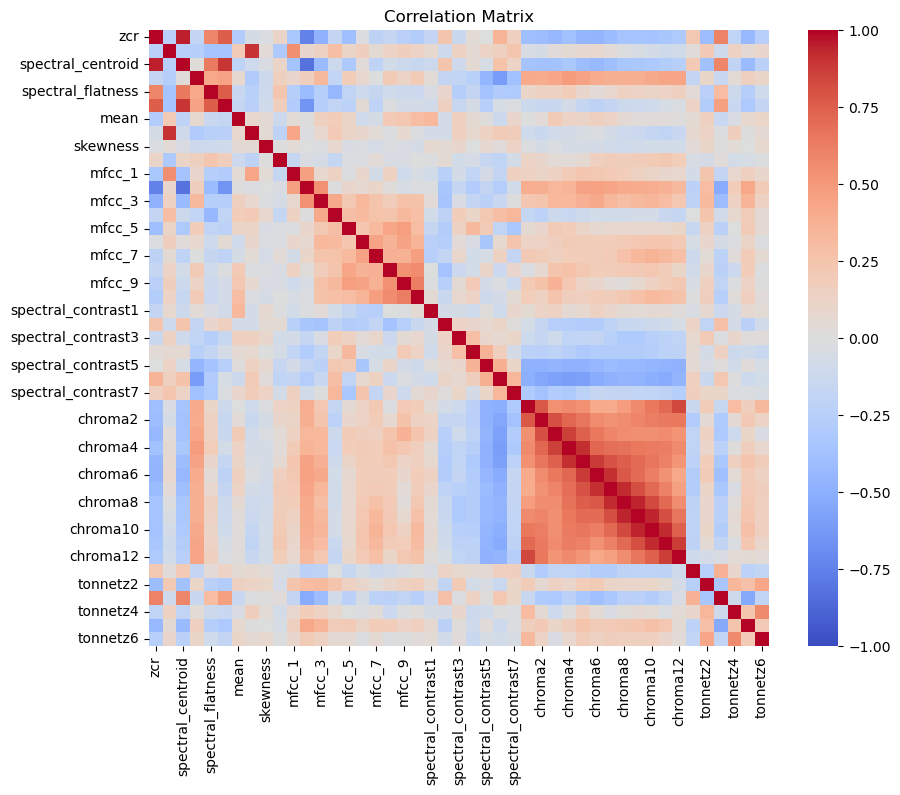

In [16]:
import seaborn as sns
corr_matrix = df[feature_names].corr()

# Plot the correlation matrix
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=False, fmt='.2f', cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Matrix')
plt.show()

## Different scaling approaches

## No scaling

In [21]:
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from pandas.plotting import scatter_matrix

def evaluate_knn(df):
    scatter_matrix(df[feature_names], c=df.label, alpha=0.8, figsize=(30, 30), s=20);
    plt.show()
    df_train, df_test = train_test_split(df, test_size = 0.2, random_state = 42)
    print("# Neighbors \t Accuracy")
    for i in range(1,16):
        knn = KNeighborsClassifier(n_neighbors=i)
        knn.fit(df_train[feature_names], df_train.label)
        preds = knn.predict(df_test[feature_names])
        print(f"{i} \t\t {len(preds[preds == df_test.label])/len(preds)*100:.2f} %")

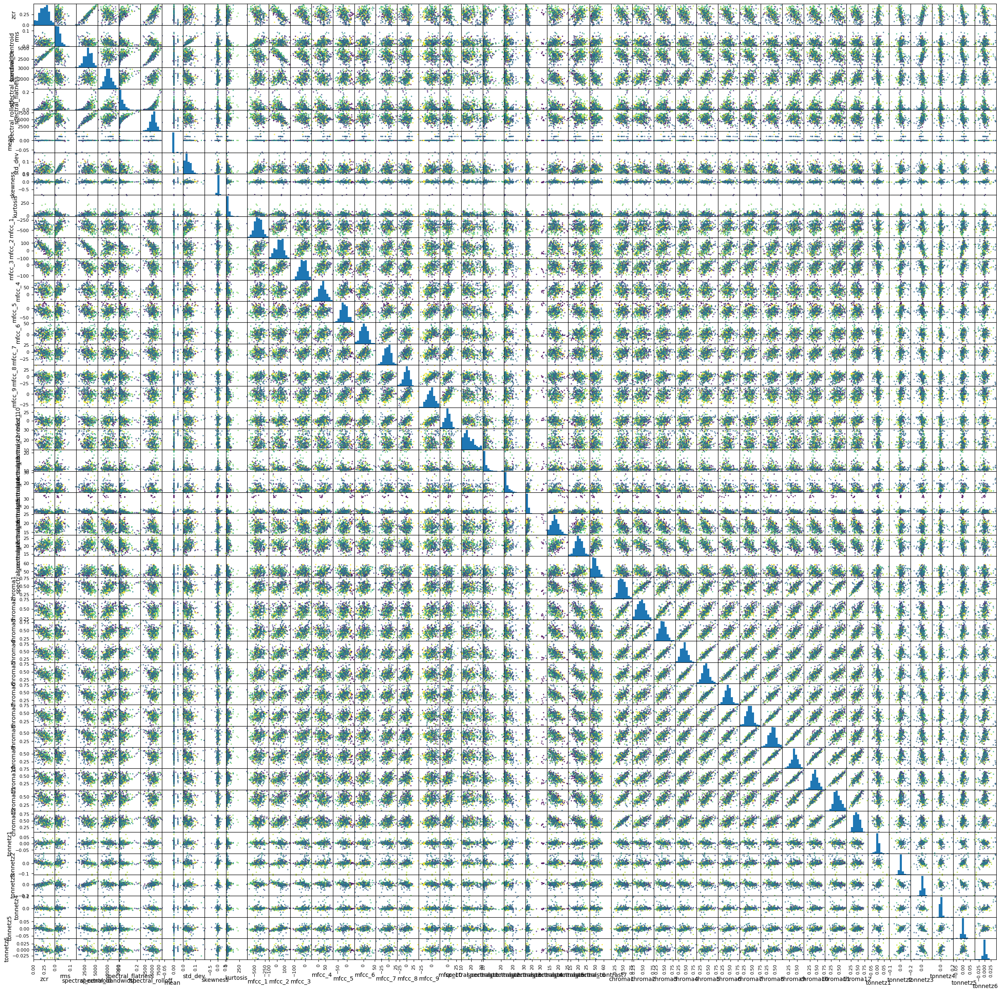

# Neighbors 	 Accuracy
1 		 6.67 %
2 		 8.33 %
3 		 6.67 %
4 		 15.00 %
5 		 13.33 %
6 		 13.33 %
7 		 16.67 %
8 		 16.67 %
9 		 13.33 %
10 		 11.67 %
11 		 13.33 %
12 		 10.00 %
13 		 10.00 %
14 		 13.33 %
15 		 11.67 %


In [22]:
evaluate_knn(df)

## With scaling

In [25]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import Normalizer
from sklearn.preprocessing import QuantileTransformer

### MinMaxScaler

In [26]:
minmax = MinMaxScaler()
df_minmax = df.copy()
df_minmax[feature_names] = pd.DataFrame(minmax.fit_transform(X = df_minmax[feature_names]), columns=feature_names)

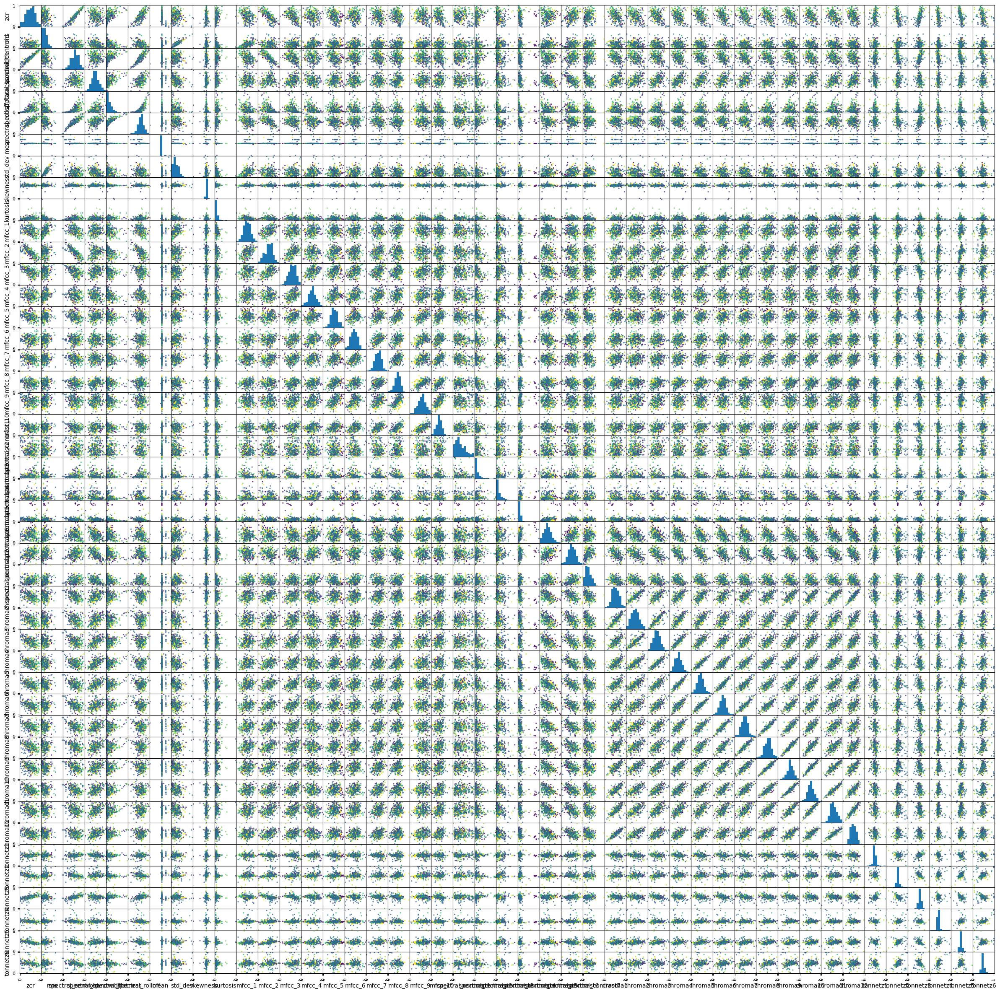

# Neighbors 	 Accuracy
1 		 38.33 %
2 		 26.67 %
3 		 31.67 %
4 		 35.00 %
5 		 30.00 %
6 		 33.33 %
7 		 36.67 %
8 		 35.00 %
9 		 38.33 %
10 		 38.33 %
11 		 33.33 %
12 		 25.00 %
13 		 28.33 %
14 		 31.67 %
15 		 30.00 %


In [27]:
evaluate_knn(df_minmax)

### StandardScaler

In [28]:
standard = StandardScaler()
df_std = df.copy()
df_std[feature_names] = pd.DataFrame(standard.fit_transform(X = df_std[feature_names]), columns=feature_names)

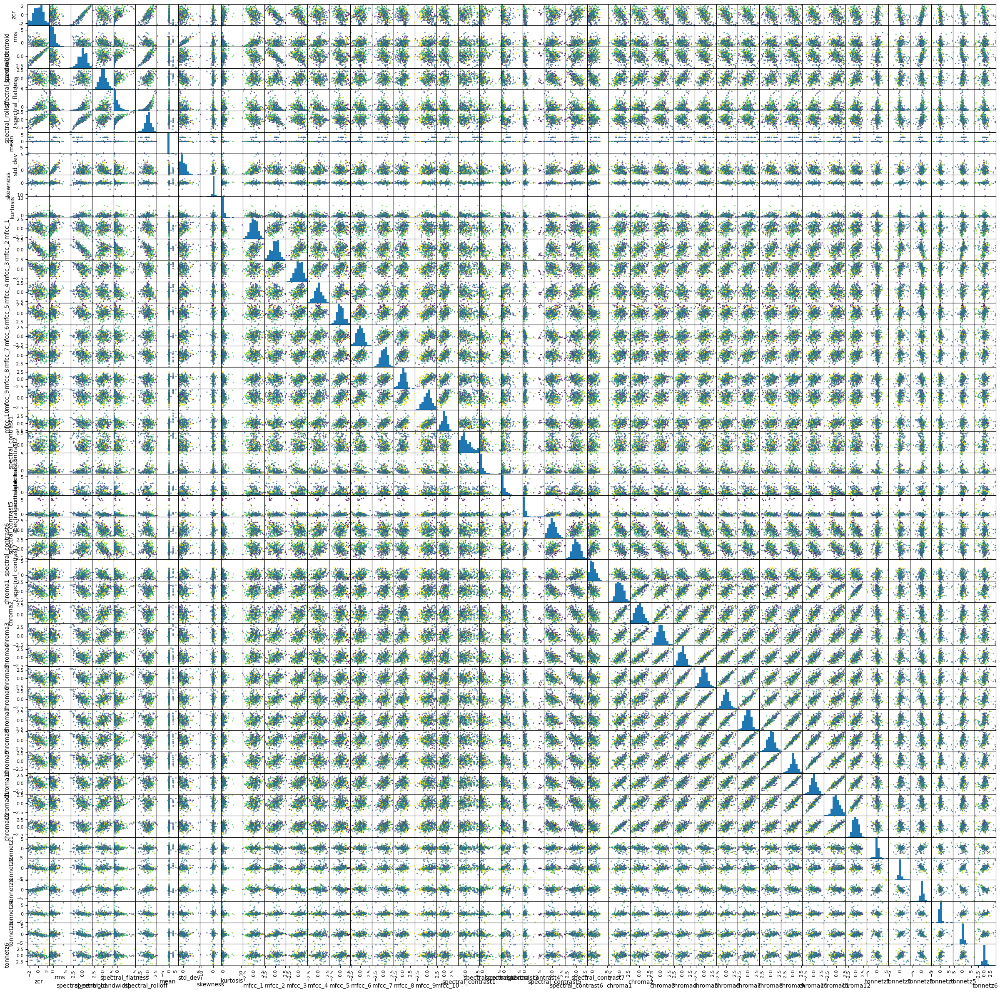

# Neighbors 	 Accuracy
1 		 36.67 %
2 		 26.67 %
3 		 28.33 %
4 		 31.67 %
5 		 33.33 %
6 		 31.67 %
7 		 30.00 %
8 		 30.00 %
9 		 35.00 %
10 		 31.67 %
11 		 35.00 %
12 		 33.33 %
13 		 30.00 %
14 		 31.67 %
15 		 30.00 %


In [29]:
evaluate_knn(df_std)

### RobustScaler

In [30]:
robust = RobustScaler()
df_robust = df.copy()
df_robust[feature_names] = pd.DataFrame(robust.fit_transform(X = df_robust[feature_names]), columns=feature_names)

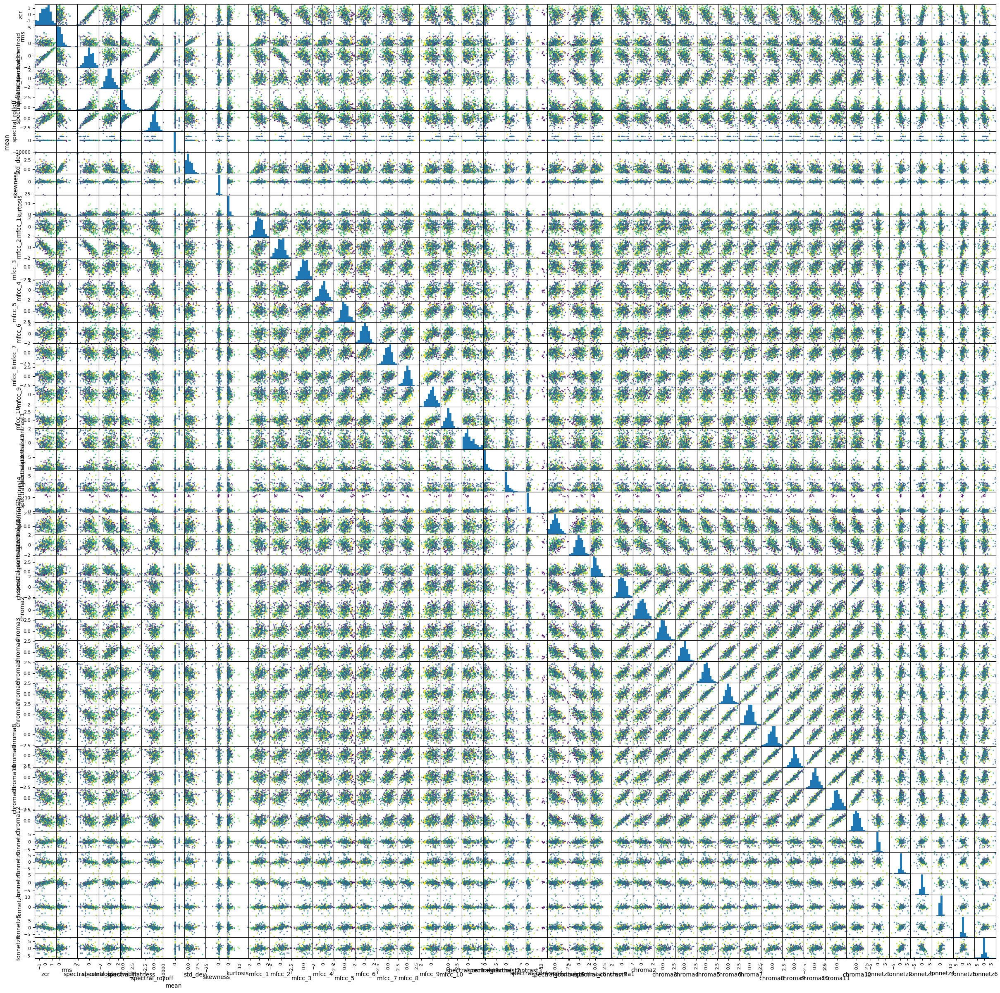

# Neighbors 	 Accuracy
1 		 35.00 %
2 		 35.00 %
3 		 28.33 %
4 		 30.00 %
5 		 33.33 %
6 		 33.33 %
7 		 33.33 %
8 		 28.33 %
9 		 31.67 %
10 		 30.00 %
11 		 30.00 %
12 		 31.67 %
13 		 33.33 %
14 		 30.00 %
15 		 33.33 %


In [31]:
evaluate_knn(df_robust)

### Normalizer

In [32]:
normalizer = Normalizer()
df_norm = df.copy()
df_norm[feature_names] = pd.DataFrame(normalizer.fit_transform(X = df_norm[feature_names]), columns=feature_names)

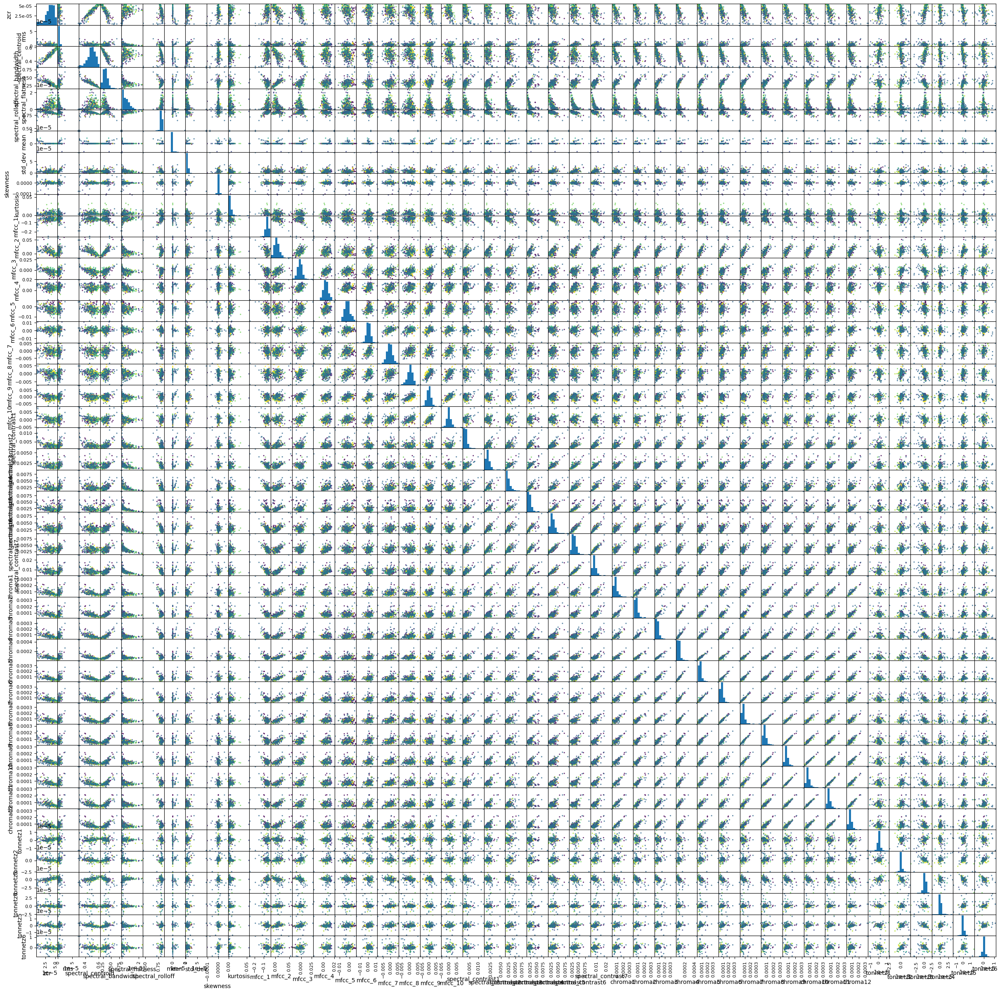

# Neighbors 	 Accuracy
1 		 13.33 %
2 		 16.67 %
3 		 13.33 %
4 		 13.33 %
5 		 20.00 %
6 		 20.00 %
7 		 18.33 %
8 		 15.00 %
9 		 16.67 %
10 		 18.33 %
11 		 21.67 %
12 		 20.00 %
13 		 21.67 %
14 		 18.33 %
15 		 20.00 %


In [33]:
evaluate_knn(df_norm)

### QuantileTransformer

In [34]:
quant = QuantileTransformer(output_distribution='normal')
df_quant = df.copy()
df_quant[feature_names] = pd.DataFrame(quant.fit_transform(X = df_quant[feature_names]), columns=feature_names)

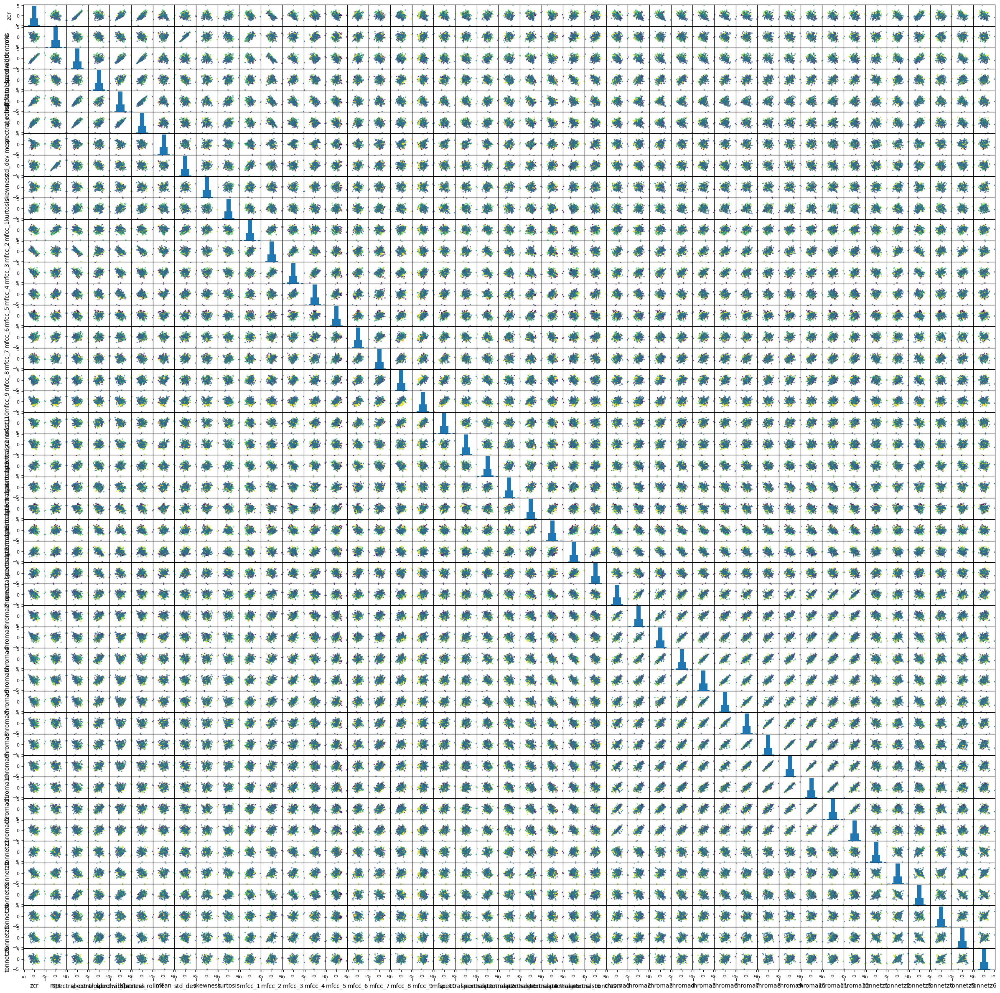

# Neighbors 	 Accuracy
1 		 40.00 %
2 		 36.67 %
3 		 41.67 %
4 		 35.00 %
5 		 35.00 %
6 		 28.33 %
7 		 36.67 %
8 		 36.67 %
9 		 36.67 %
10 		 36.67 %
11 		 31.67 %
12 		 35.00 %
13 		 33.33 %
14 		 31.67 %
15 		 33.33 %


In [35]:
evaluate_knn(df_quant)

## Principal Component Analysis

In [36]:
from sklearn.decomposition import PCA

pca = PCA(n_components=15)  # Retain 95% of the variance
principal_components = pca.fit_transform(df_std[feature_names])

(300, 15)


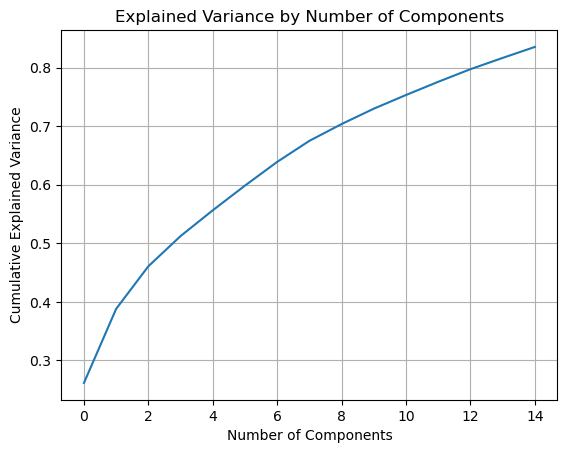

In [37]:
# Check the shape of the transformed data
print(principal_components.shape)

# Plot the explained variance
plt.figure()
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('Explained Variance by Number of Components')
plt.grid()
plt.show()

In [38]:
def evaluate_pca(pca):
    scatter_matrix(pca, c=df.label, alpha=0.8, figsize=(30, 30), s=20);
    plt.show()
    X_train, X_test, y_train, y_test = train_test_split(pca, df.label, test_size=0.2, random_state=42)
    print("# Neighbors \t Accuracy")
    for i in range(1,16):
        knn = KNeighborsClassifier(n_neighbors=i)
        knn.fit(X_train, y_train)
        preds = knn.predict(X_test)
        print(f"{i} \t\t {len(preds[preds == y_test])/len(preds)*100:.2f} %")

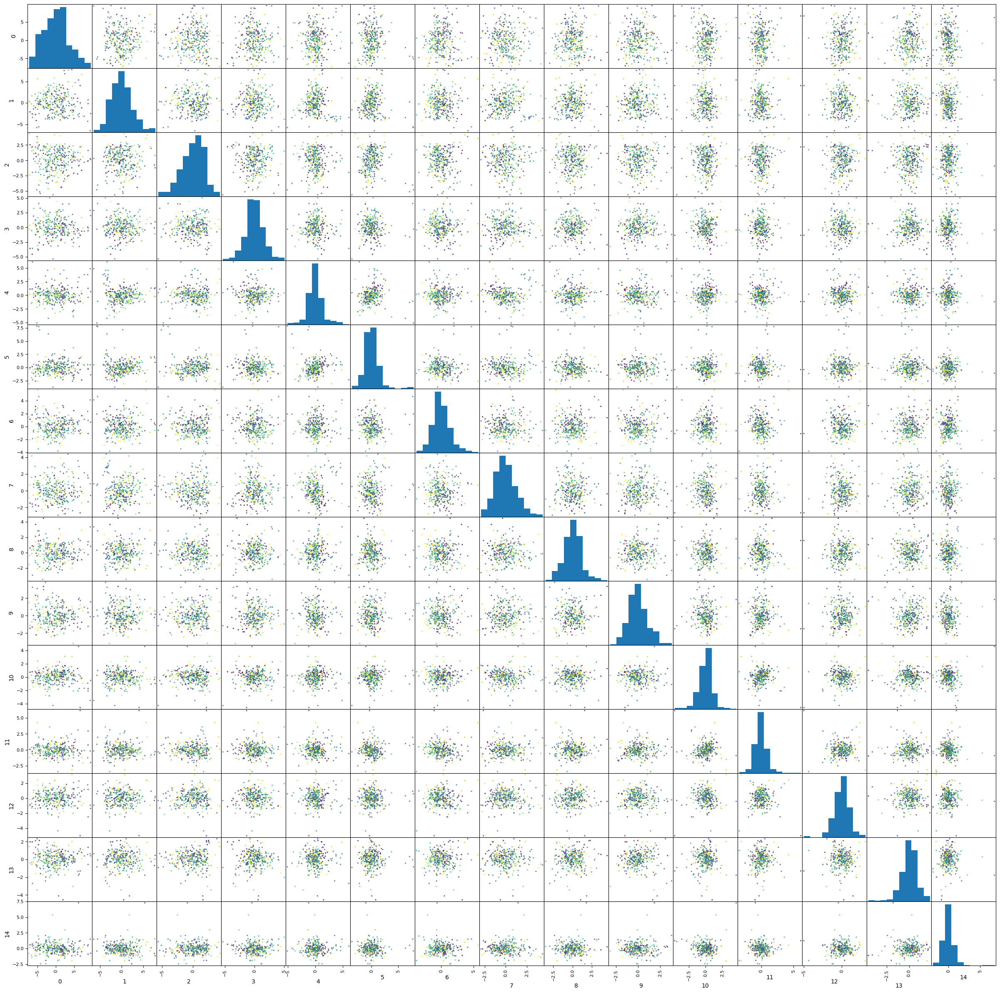

# Neighbors 	 Accuracy
1 		 38.33 %
2 		 31.67 %
3 		 25.00 %
4 		 25.00 %
5 		 26.67 %
6 		 28.33 %
7 		 30.00 %
8 		 28.33 %
9 		 31.67 %
10 		 28.33 %
11 		 23.33 %
12 		 28.33 %
13 		 25.00 %
14 		 23.33 %
15 		 21.67 %


In [39]:
df_pca = pd.DataFrame(principal_components)
evaluate_pca(df_pca)